In [77]:
import pandas as pd
import numpy as np

from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.feature_selection import VarianceThreshold
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.decomposition import PCA

from imblearn.over_sampling import ADASYN

import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')


In [49]:
train=pd.read_csv("train.csv")
X=train.loc[:,"product_code":"measurement_17"]
y=train["failure"]
test=pd.read_csv("test.csv")
X_test=test.loc[:,"product_code":"measurement_17"]
product=X['product_code']
X=X.drop(['product_code'], axis=1)
X_test=X_test.drop(['product_code'], axis=1)
display(X, X_test)

,loading,attribute_0,attribute_1,attribute_2,attribute_3,measurement_0,measurement_1,measurement_2,measurement_3,measurement_4,...,measurement_8,measurement_9,measurement_10,measurement_11,measurement_12,measurement_13,measurement_14,measurement_15,measurement_16,measurement_17
0,80.10,material_7,material_8,9,5,7,8,4,18.040,12.518,...,20.155,10.672,15.859,17.594,15.193,15.029,NaN,13.034,14.684,764.100
1,84.89,material_7,material_8,9,5,14,3,3,18.213,11.540,...,17.889,12.448,17.947,17.915,11.755,14.732,15.425,14.395,15.631,682.057
2,82.43,material_7,material_8,9,5,12,1,5,18.057,11.652,...,18.288,12.715,15.607,NaN,13.798,16.711,18.631,14.094,17.946,663.376
3,101.07,material_7,material_8,9,5,13,2,6,17.295,11.188,...,19.060,12.471,16.346,18.377,10.020,15.250,15.562,16.154,17.172,826.282
4,188.06,material_7,material_8,9,5,9,2,8,19.346,12.950,...,18.093,10.337,17.082,19.932,12.428,16.182,12.760,13.153,16.412,579.885
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26565,158.95,material_7,material_6,6,9,6,16,4,16.301,13.259,...,19.354,NaN,12.177,17.942,10.112,15.795,18.572,16.144,NaN,729.131
26566,146.02,material_7,material_6,6,9,10,12,8,17.543,NaN,...,19.563,11.242,14.179,20.564,10.234,14.450,14.322,13.146,16.471,853.924
26567,115.62,material_7,material_6,6,9,1,10,1,15.670,11.535,...,19.279,11.407,16.437,17.476,8.668,15.069,16.599,15.590,14.065,750.364
26568,106.38,material_7,material_6,6,9,2,9,4,18.059,NaN,...,19.358,11.392,17.064,17.814,14.928,16.273,15.485,13.624,12.865,730.156


,loading,attribute_0,attribute_1,attribute_2,attribute_3,measurement_0,measurement_1,measurement_2,measurement_3,measurement_4,...,measurement_8,measurement_9,measurement_10,measurement_11,measurement_12,measurement_13,measurement_14,measurement_15,measurement_16,measurement_17
0,119.57,material_5,material_6,6,4,6,9,6,19.305,10.178,...,18.654,10.802,15.909,18.070,13.772,13.659,16.825,13.742,17.710,634.612
1,113.51,material_5,material_6,6,4,11,8,0,17.883,11.927,...,19.368,12.032,13.998,NaN,12.473,17.468,16.708,14.776,14.102,537.037
2,112.16,material_5,material_6,6,4,8,12,4,18.475,10.481,...,17.774,11.743,17.046,18.086,10.907,13.363,15.737,17.065,16.021,658.995
3,112.72,material_5,material_6,6,4,8,11,10,16.518,10.888,...,18.948,11.790,18.165,16.163,10.933,15.501,15.667,12.620,16.111,594.301
4,208.00,material_5,material_6,6,4,14,16,8,17.808,12.693,...,19.141,12.370,14.578,17.849,11.941,16.070,16.183,13.324,17.150,801.044
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20770,144.74,material_7,material_5,9,5,0,4,9,18.465,12.570,...,18.573,11.691,NaN,19.771,11.562,17.246,15.131,15.209,NaN,696.466
20771,74.53,material_7,material_5,9,5,4,8,7,18.900,9.896,...,17.917,10.980,16.027,15.694,13.564,15.494,15.296,13.812,16.501,613.249
20772,67.73,material_7,material_5,9,5,10,11,2,18.656,NaN,...,19.630,10.436,16.137,20.612,11.134,16.519,15.525,14.175,17.728,783.349
20773,126.15,material_7,material_5,9,5,8,16,11,16.536,11.226,...,19.575,12.672,15.422,19.496,9.319,15.817,17.403,16.437,15.179,745.210


In [50]:
d_mt={'material_5':0, 'material_6':1, 'material_7': 2, 'material_8':3}

In [51]:
X=X.replace({'attribute_0': d_mt})
X=X.replace({'attribute_1': d_mt})

X_test=X_test.replace({'attribute_0': d_mt})
X_test=X_test.replace({'attribute_1': d_mt})

# X['m_3_missing'] = X.measurement_3.isna()
# X['m_5_missing'] = X.measurement_5.isna()
# X_test['m_3_missing'] = X_test.measurement_3.isna()
# X_test['m_5_missing'] = X_test.measurement_5.isna()

In [52]:
for column in X.columns:
    if not type(X[column][0])==str:
        X[column].fillna(X[column].mean(), inplace=True)

In [53]:
for column in X_test.columns:
    if not type(X_test[column][0])==str:
        X_test[column].fillna(X_test[column].mean(), inplace=True)

In [11]:
logreg=LogisticRegression()
logreg.fit(X_resampled, y_resampled)
y_test=logreg.predict(X_test)
y_proba=logreg.predict_proba(X_test)
print(y_test, y_proba)

[1 1 1 ... 0 0 0] [[0.16966623 0.83033377]
 [0.18337471 0.81662529]
 [0.22933685 0.77066315]
 ...
 [0.5440137  0.4559863 ]
 [0.64804052 0.35195948]
 [0.52360101 0.47639899]]


In [12]:
res=[y_proba[i][1] for i in range(len(y_proba))]
ind=[i for i in range(26570, 47345)]
print(res, ind)

[0.8303337741603738, 0.816625294763581, 0.7706631527016132, 0.6760744486610408, 0.7291759712280776, 0.6982136935739854, 0.5341636459567494, 0.806787962301745, 0.7019379983931185, 0.6345232938651122, 0.5013433682405533, 0.7414072540571889, 0.5556488764017504, 0.6715843584807578, 0.8664492716737325, 0.4791729474576153, 0.5968087482256135, 0.6374949719400685, 0.827816121239871, 0.7061101834390953, 0.7142953344673051, 0.7004118016569517, 0.7669761125327862, 0.7814077082717612, 0.5411196493206435, 0.8940792995544283, 0.7620897833994681, 0.824357613566419, 0.8783571031530134, 0.863616692643051, 0.6907211456100727, 0.6723417841734769, 0.8562575407462145, 0.7642630061229444, 0.7315192407934444, 0.5978685864342549, 0.601858073785895, 0.5733339242477882, 0.6700280703163123, 0.8367422155146839, 0.5583978623407039, 0.5241057203677025, 0.5735164014008739, 0.7470805049111644, 0.600799925181135, 0.6735857165600281, 0.5994239868562815, 0.7253284081009391, 0.7325881605640652, 0.7530475469072454, 0.6796

In [13]:
y_f=pd.DataFrame(res, ind, columns=['failure'])
y_f.to_csv('Subm2.csv')

In [143]:
rand=RandomForestClassifier()
rand.fit(X_resampled, y_resampled)
y_test=rand.predict(X_test)
y_proba=rand.predict_proba(X_test)
print(y_test, y_proba)
res=[y_proba[i][1] for i in range(len(y_proba))]
ind=[i for i in range(26570, 47345)]
# print(res, ind)
y_f=pd.DataFrame(res, ind, columns=['failure'])
y_f.to_csv('Subm3.csv')

[1 1 1 ... 1 0 1] [[0.03 0.97]
 [0.11 0.89]
 [0.07 0.93]
 ...
 [0.29 0.71]
 [0.5  0.5 ]
 [0.38 0.62]]
[0.97, 0.89, 0.93, 0.86, 0.85, 0.87, 0.87, 0.97, 0.91, 0.95, 0.83, 0.88, 0.88, 0.89, 0.92, 0.76, 0.88, 0.91, 0.97, 0.89, 0.85, 0.98, 0.93, 0.99, 0.95, 0.97, 0.88, 0.96, 0.88, 0.91, 0.85, 0.83, 0.98, 0.88, 0.95, 0.93, 0.82, 0.88, 0.93, 0.87, 0.84, 0.91, 0.86, 0.92, 0.88, 0.95, 0.9, 0.89, 0.86, 0.87, 0.89, 0.95, 0.92, 0.93, 0.9, 0.97, 0.92, 0.92, 0.84, 0.98, 0.96, 0.97, 0.99, 0.97, 0.93, 0.99, 0.98, 0.9, 0.9, 0.9, 0.86, 0.85, 0.87, 0.83, 0.95, 0.95, 0.9, 0.91, 0.88, 0.84, 0.9, 0.96, 0.93, 0.92, 0.91, 0.97, 0.97, 0.98, 1.0, 0.97, 0.87, 0.92, 0.97, 0.93, 0.83, 0.88, 0.88, 0.88, 0.82, 1.0, 0.9, 0.87, 0.96, 0.98, 0.9, 0.85, 0.9, 0.96, 1.0, 0.94, 0.93, 0.84, 0.93, 0.99, 0.9, 0.9, 0.88, 0.9, 0.92, 1.0, 0.85, 0.87, 0.85, 0.97, 0.85, 0.91, 0.92, 0.95, 1.0, 0.86, 1.0, 0.94, 0.9, 0.91, 0.84, 0.93, 0.95, 0.99, 0.93, 0.9, 0.9, 0.82, 0.99, 0.92, 0.86, 0.98, 0.98, 0.99, 0.93, 0.92, 0.88, 0.93, 0.86, 0

In [37]:
logreg=LogisticRegression(C=1, fit_intercept=True, penalty='l2', solver='newton-cg')
logreg.fit(X_resampled, y_resampled)
y_test=logreg.predict(X_test)
y_proba=logreg.predict_proba(X_test)
print(y_test, y_proba)
res=[y_proba[i][1] for i in range(len(y_proba))]
ind=[i for i in range(26570, 47345)]
print(res, ind)
y_f=pd.DataFrame(res, ind, columns=['failure'])
y_f.to_csv('Subm4.csv')

[1 1 1 ... 0 0 0] [[0.03354403 0.96645597]
 [0.0264649  0.9735351 ]
 [0.04459    0.95541   ]
 ...
 [0.69023217 0.30976783]
 [0.79077683 0.20922317]
 [0.73022246 0.26977754]]
[0.9664559709302755, 0.9735350970853143, 0.955409999569323, 0.9266945832434479, 0.9500158720710888, 0.927466850194708, 0.8908844349294477, 0.9644604985946689, 0.9317833962982983, 0.9207237474053498, 0.8777983939634636, 0.9612897889511139, 0.8759296630371982, 0.9193906329939523, 0.9796657327489078, 0.8657696662998595, 0.8978775501548409, 0.9283499221634071, 0.9537783318347937, 0.9511078578989618, 0.9590855144275962, 0.9451366588587197, 0.9548587865777104, 0.9619067062177613, 0.887354161592262, 0.9749205998629386, 0.9406718416486924, 0.971545135295325, 0.9726966565772225, 0.9703815964752289, 0.9430345695753184, 0.9311798540634576, 0.9739341245587118, 0.9576468902809112, 0.9382957352768971, 0.918347849699629, 0.9029973730804427, 0.9076200218054765, 0.9238517214466384, 0.973879476171557, 0.8903370757551426, 0.825963940

In [35]:
paramet={'penalty':('none', 'l2', 'l1', 'elasticnet'), 'solver':('newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'),'C':[1,10],'fit_intercept':[True, False]}

In [36]:
clf=GridSearchCV(LogisticRegression(), paramet)
clf.fit(X_resampled, y_resampled)
print(clf.best_params_)

{'C': 1, 'fit_intercept': True, 'penalty': 'l2', 'solver': 'newton-cg'}


In [39]:
knn=KNeighborsClassifier()
knn.fit(X_resampled, y_resampled)
y_test=knn.predict(X_test)
y_proba=knn.predict_proba(X_test)
print(y_test, y_proba)
res=[y_proba[i][1] for i in range(len(y_proba))]
ind=[i for i in range(26570, 47345)]
print(res, ind)
y_f=pd.DataFrame(res, ind, columns=['failure'])
y_f.to_csv('Subm5.csv')

[1 0 0 ... 0 0 0] [[0.  1. ]
 [1.  0. ]
 [0.6 0.4]
 ...
 [1.  0. ]
 [0.6 0.4]
 [1.  0. ]]
[1.0, 0.0, 0.4, 0.0, 0.8, 0.4, 0.2, 1.0, 0.8, 0.0, 1.0, 0.6, 0.8, 0.0, 0.8, 0.0, 0.8, 0.4, 0.2, 0.8, 0.0, 0.2, 0.2, 0.8, 0.4, 0.8, 0.2, 0.8, 1.0, 0.8, 0.8, 0.6, 0.2, 0.4, 0.0, 0.0, 0.6, 0.2, 0.8, 0.6, 0.4, 0.0, 0.2, 0.6, 0.0, 0.6, 0.8, 0.6, 0.4, 0.8, 0.6, 0.2, 0.6, 0.8, 0.8, 0.0, 0.4, 1.0, 0.0, 0.4, 0.8, 0.8, 0.0, 0.6, 0.6, 0.6, 0.8, 0.4, 0.0, 0.4, 0.0, 0.0, 0.4, 0.4, 0.8, 0.2, 0.4, 0.4, 0.6, 0.8, 0.8, 0.2, 0.0, 0.4, 0.4, 0.0, 0.8, 0.8, 0.2, 0.6, 0.8, 0.0, 0.8, 0.8, 0.8, 0.6, 0.4, 0.4, 0.4, 0.6, 1.0, 0.2, 0.0, 0.8, 0.8, 0.0, 0.2, 1.0, 0.6, 0.8, 0.6, 0.6, 0.0, 0.4, 0.2, 0.2, 0.6, 0.4, 0.4, 0.6, 1.0, 0.2, 0.2, 0.0, 0.0, 1.0, 0.6, 0.0, 0.8, 1.0, 1.0, 0.6, 0.0, 0.8, 0.2, 0.4, 0.4, 0.4, 0.4, 0.2, 0.8, 0.6, 0.6, 1.0, 0.8, 0.8, 0.0, 0.0, 0.8, 0.0, 0.8, 0.4, 0.2, 0.4, 0.6, 0.8, 0.4, 0.0, 0.4, 0.6, 0.0, 0.2, 0.2, 0.6, 0.8, 0.2, 0.2, 0.6, 0.6, 0.6, 0.6, 0.4, 0.2, 0.0, 0.8, 1.0, 0.2, 0.0, 0.8, 0.8, 1.0, 0.8,

In [17]:
help(sns. heatmap)


Help on function heatmap in module seaborn.matrix:

heatmap(data, *, vmin=None, vmax=None, cmap=None, center=None, robust=False, annot=None, fmt='.2g', annot_kws=None, linewidths=0, linecolor='white', cbar=True, cbar_kws=None, cbar_ax=None, square=False, xticklabels='auto', yticklabels='auto', mask=None, ax=None, **kwargs)
    Plot rectangular data as a color-encoded matrix.
    
    This is an Axes-level function and will draw the heatmap into the
    currently-active Axes if none is provided to the ``ax`` argument.  Part of
    this Axes space will be taken and used to plot a colormap, unless ``cbar``
    is False or a separate Axes is provided to ``cbar_ax``.
    
    Parameters
    ----------
    data : rectangular dataset
        2D dataset that can be coerced into an ndarray. If a Pandas DataFrame
        is provided, the index/column information will be used to label the
        columns and rows.
    vmin, vmax : floats, optional
        Values to anchor the colormap, otherwise 

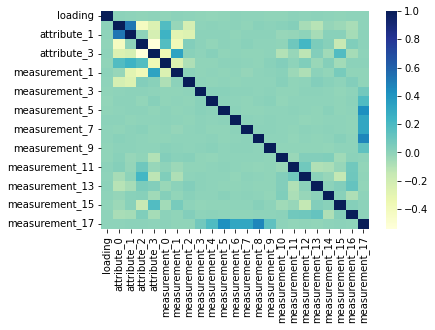

In [18]:
corre=X.corr()
sns.heatmap(corre, cmap='YlGnBu', annot=False)
plt.show()

In [29]:
X_temp=X

In [30]:
sel = VarianceThreshold(threshold=(.8 * (1 - .8)))
sel.fit_transform(X_temp)
print(X.shape, X_temp.shape)

(26570, 23) (26570, 23)


In [36]:
X_resampled=X_resampled[['attribute_1', 'attribute_3', 'measurement_1', 'measurement_3', 'measurement_5', 'measurement_6', 'measurement_7', 'measurement_8', 'measurement_9', 'measurement_17']]
X_test=X_test[['attribute_1', 'attribute_3', 'measurement_1', 'measurement_3', 'measurement_5', 'measurement_6', 'measurement_7', 'measurement_8', 'measurement_9', 'measurement_17']]

In [34]:
X_resampled

,attribute_1,attribute_3,measurement_1,measurement_3,measurement_5,measurement_6,measurement_7,measurement_8,measurement_9,measurement_17
0,3,5,8,18.040000,15.748000,19.292000,11.739000,20.155000,10.672000,764.100000
1,3,5,3,18.213000,17.717000,17.893000,12.748000,17.889000,12.448000,682.057000
2,3,5,1,18.057000,16.738000,18.240000,12.718000,18.288000,12.715000,663.376000
3,3,5,2,17.295000,18.576000,18.339000,12.583000,19.060000,12.471000,826.282000
4,3,5,2,19.346000,16.990000,15.746000,11.306000,18.093000,10.337000,579.885000
...,...,...,...,...,...,...,...,...,...,...
42806,1,9,9,17.821502,17.691753,18.540344,11.604722,18.541470,11.281438,701.269059
42807,2,8,13,16.232459,18.236417,17.484300,11.813295,22.448293,12.154764,1104.091698
42808,1,9,9,18.890016,18.012766,18.163540,11.916668,19.562589,12.272716,1063.013588
42809,1,9,9,17.075502,18.976326,18.823540,11.615309,19.744337,11.798207,1067.546348


In [37]:
logreg=LogisticRegression(C=1, fit_intercept=True, penalty='l2', solver='newton-cg')
logreg.fit(X_resampled, y_resampled)
y_test=logreg.predict(X_test)
y_proba=logreg.predict_proba(X_test)
print(y_test, y_proba)
res=[y_proba[i][1] for i in range(len(y_proba))]
ind=[i for i in range(26570, 47345)]
print(res, ind)
y_f=pd.DataFrame(res, ind, columns=['failure'])
y_f.to_csv('Subm6.csv')

[1 1 1 ... 1 1 1] [[0.37285045 0.62714955]
 [0.3869501  0.6130499 ]
 [0.40316868 0.59683132]
 ...
 [0.35799877 0.64200123]
 [0.40278431 0.59721569]
 [0.38546373 0.61453627]]
[0.6271495492243033, 0.6130499006341205, 0.5968313243855726, 0.5900812184621965, 0.591360882845342, 0.6181371024851231, 0.5389557022789266, 0.6415397828780167, 0.596209849826266, 0.5910328778459706, 0.5666208658785727, 0.6458865029421533, 0.6093481336148054, 0.5931435071466712, 0.6633521133809729, 0.5632505127302168, 0.5848453736399937, 0.6385386628297256, 0.6253229727956713, 0.593099732786619, 0.5827842104552254, 0.591843768433194, 0.6447929747413478, 0.6308382439807564, 0.5830745578181555, 0.6229180129990627, 0.6112339364552699, 0.6330276655378568, 0.6706107157637048, 0.6575928722426327, 0.5848473528559415, 0.5638174065093026, 0.5957757144041745, 0.599858941178519, 0.6004690616672884, 0.5941101688222682, 0.5459519361860677, 0.5702292471647148, 0.5521796867964573, 0.6573685777469648, 0.5776185177431812, 0.60818159

In [13]:
svm=SVC()
svm.fit(X, y)
y_test=svm.predict(X_test)
y_proba=svm.predict_proba(X_test)
# print(y_test, y_proba)
res=[y_proba[i][1] for i in range(len(y_proba))]
ind=[i for i in range(26570, 47345)]
# print(res, ind)
y_f=pd.DataFrame(res, ind, columns=['failure'])
y_f.to_csv('Subm8.csv')

AttributeError: predict_proba is not available when  probability=False

In [39]:
logreg=LogisticRegression()
logreg.fit(X_resampled, y_resampled)
y_test=logreg.predict(X_test)
y_proba=logreg.predict_proba(X_test)
# print(y_test, y_proba)
res=[y_proba[i][1] for i in range(len(y_proba))]
ind=[i for i in range(26570, 47345)]
# print(res, ind)
y_f=pd.DataFrame(res, ind, columns=['failure'])
y_f.to_csv('Subm7.csv')

In [11]:
tree=DecisionTreeClassifier()
tree.fit(X, y)
y_test=tree.predict(X_test)
y_proba=tree.predict_proba(X_test)
# print(y_test, y_proba)
res=[y_proba[i][1] for i in range(len(y_proba))]
ind=[i for i in range(26570, 47345)]
# print(res, ind)
y_f=pd.DataFrame(res, ind, columns=['failure'])
y_f.to_csv('Subm10.csv')

In [22]:
quad=QuadraticDiscriminantAnalysis()
quad.fit(X, y)
y_test=quad.predict(X_test)
y_proba=quad.predict_proba(X_test)
# print(y_test, y_proba)
res=[y_proba[i][1] for i in range(len(y_proba))]
ind=[i for i in range(26570, 47345)]
# print(res, ind)
y_f=pd.DataFrame({'id':ind, 'failure':res}, columns=['id','failure'])
y_f.to_csv('Subm11.csv')

In [65]:
logreg=LogisticRegression()
logreg.fit(X, y)
y_test=logreg.predict(X_test)
y_proba=logreg.predict_proba(X_test)
# print(y_test, y_proba)
res=[y_proba[i][1] for i in range(len(y_proba))]
ind=[i for i in range(26570, 47345)]
# print(res, ind)
y_f=pd.DataFrame({'id':ind, 'failure':res}, columns=['id','failure'])
y_f.to_csv('Subm12.csv', index=False)

In [63]:
X_loading=X[['loading']]
X_loading_test=X_test[['loading']]
type(X_loading)

pandas.core.frame.DataFrame

In [66]:
logreg=LogisticRegression()
logreg.fit(X_loading, y)
y_test=logreg.predict(X_loading_test)
y_proba=logreg.predict_proba(X_loading_test)
# print(y_test, y_proba)
res=[y_proba[i][1] for i in range(len(y_proba))]
ind=[i for i in range(26570, 47345)]
# print(res, ind)
y_f=pd.DataFrame({'id':ind, 'failure':res}, columns=['id','failure'])
y_f.to_csv('Subm13.csv', index=False)

In [75]:
pca=PCA(n_components='mle')
X_pca=X
X_test_pca=X_test
pca.fit(X)
pca.transform(X_pca)
pca.transform(X_test_pca)
print(X.shape, X_pca.shape, X_test.shape, X_test_pca.shape)

(26570, 23) (26570, 23) (20775, 23) (20775, 23)


In [ ]:
logreg=LogisticRegression()
logreg.fit(X_pca, y)
y_test=logreg.predict(X_test_pca)
y_proba=logreg.predict_proba(X_test_pca)
# print(y_test, y_proba)
res=[y_proba[i][1] for i in range(len(y_proba))]
ind=[i for i in range(26570, 47345)]
# print(res, ind)
y_f=pd.DataFrame({'id':ind, 'failure':res}, columns=['id','failure'])
y_f.to_csv('Subm14.csv', index=False)

In [79]:
gbc=GradientBoostingClassifier()
gbc.fit(X, y)
y_test=gbc.predict(X_test)
y_proba=gbc.predict_proba(X_test)
# print(y_test, y_proba)
res=[y_proba[i][1] for i in range(len(y_proba))]
ind=[i for i in range(26570, 47345)]
# print(res, ind)
y_f=pd.DataFrame({'id':ind, 'failure':res}, columns=['id','failure'])
y_f.to_csv('Subm15.csv', index=False)

In [33]:
y

0        0
1        0
2        0
3        0
4        0
        ..
26565    0
26566    0
26567    0
26568    0
26569    0
Name: failure, Length: 26570, dtype: int64

In [39]:
colors={0:'lightgreen', 1:'darkred'}

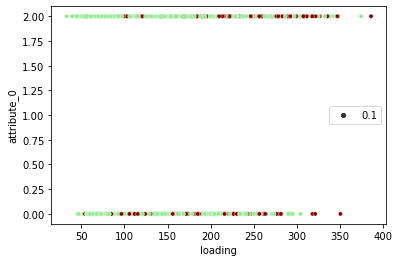

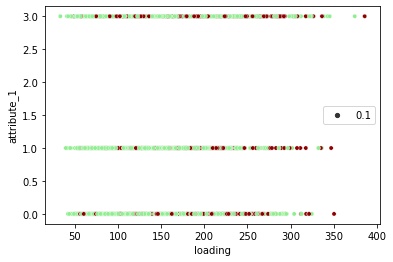

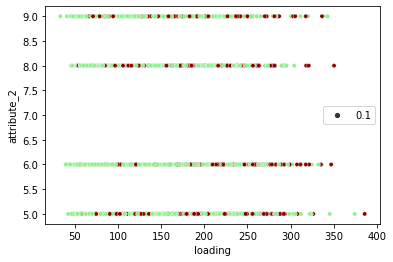

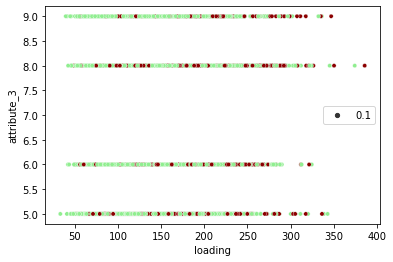

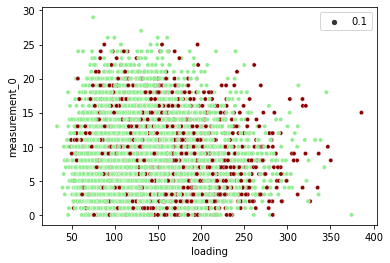

...

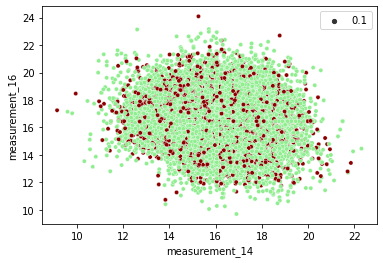

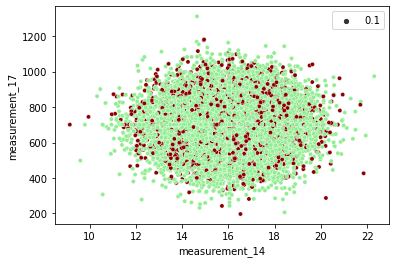

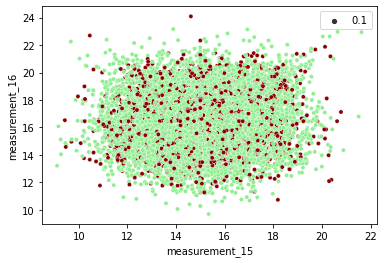

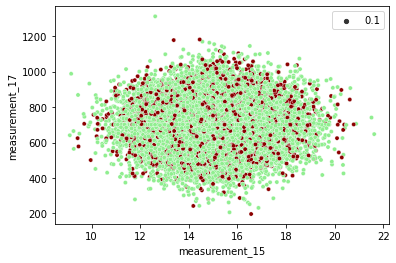

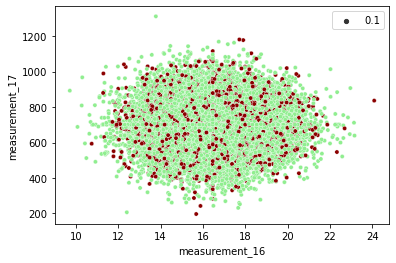

In [40]:
columns=X.columns
for i in range(len(columns)-1):
    for j in range(i+1, len(columns)):
        sns.scatterplot(columns[i], columns[j], data=X, c=y.map(colors), size=.1)
        plt.show()

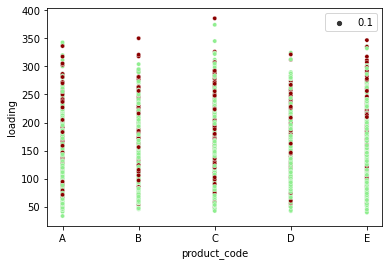

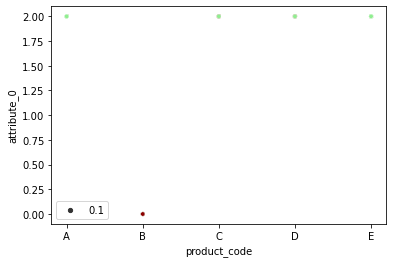

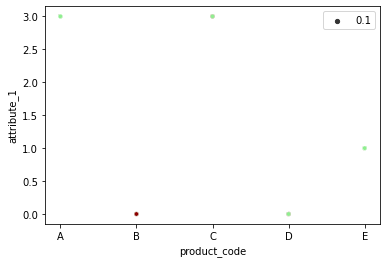

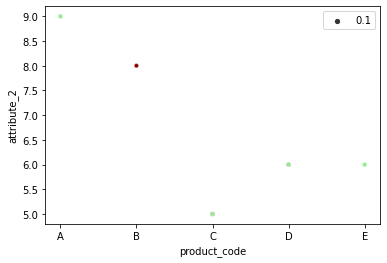

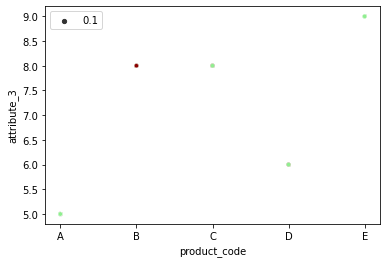

...

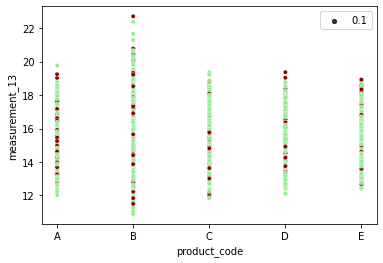

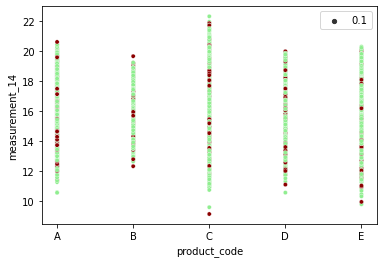

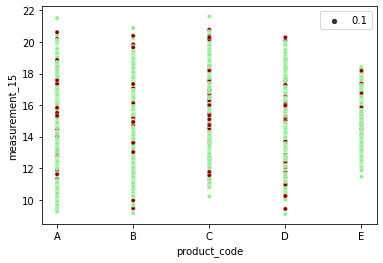

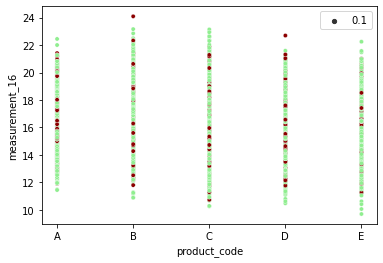

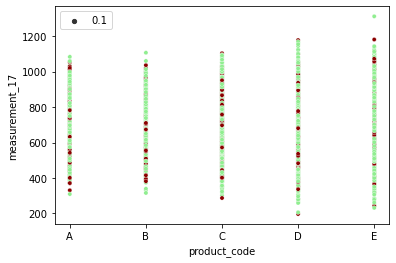

In [54]:
for col in columns:
    sns.scatterplot(product, X[col],  data=X, c=y.map(colors), size=.1)
    plt.show()